In [1]:
# The path can also be read from a config file, etc.
OPENSLIDE_PATH = r'C:\Users\thu71\Downloads\openslide-win64-20230414\bin'

import os
if hasattr(os, 'add_dll_directory'):
    # Windows
    with os.add_dll_directory(OPENSLIDE_PATH):
        import openslide
else:
    import openslide

In [2]:
"""Import modules required to run the Jupyter notebook."""
# Clear logger to use tiatoolbox.logger
import logging
import warnings

if logging.getLogger().hasHandlers():
    logging.getLogger().handlers.clear()

import cv2
import joblib
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import (
    overlay_prediction_contours,
)
from tiatoolbox.wsicore.wsireader import WSIReader

warnings.filterwarnings("ignore")
mpl.rcParams["figure.dpi"] = 300  # for high resolution figure in notebook
mpl.rcParams["figure.facecolor"] = "white"  # To make sure text is visible in dark mode
plt.rcParams.update({"font.size": 5})

|2024-01-25|18:02:57.117| [WARNING] c:\Users\thu71\AppData\Local\anaconda3\envs\pathml\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()

|2024-01-25|18:02:57.118| [WARNING] c:\Users\thu71\AppData\Local\anaconda3\envs\pathml\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  

# Test segmentation pipeline on 1 image only 

## Read HE file

In [3]:
file_path = r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif'

reader = WSIReader.open(file_path)
print(reader)  # noqa: T201

In [4]:
reader = WSIReader.open(file_path)
print(reader)  # noqa: T201

In [5]:
info_dict = reader.info.as_dict()
print(info_dict)  # noqa: T203

|2024-01-25|18:03:01.645| [WARNING] Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
|2024-01-25|18:03:01.646| [WARNING] Metadata: Objective power inferred from microns-per-pixel (MPP).


{'objective_power': 60.0, 'slide_dimensions': (11162, 4438), 'level_count': 1, 'level_dimensions': ((11162, 4438),), 'level_downsamples': [1.0], 'vendor': 'generic-tiff', 'mpp': (0.18872087825758402, 0.18872087825758402), 'file_path': WindowsPath('Y:/coskun-lab/Thomas/23_PLA_revision/data/tissue/HE_reg_pyr/577-1197_40X.ome.tif'), 'axes': 'YXS'}


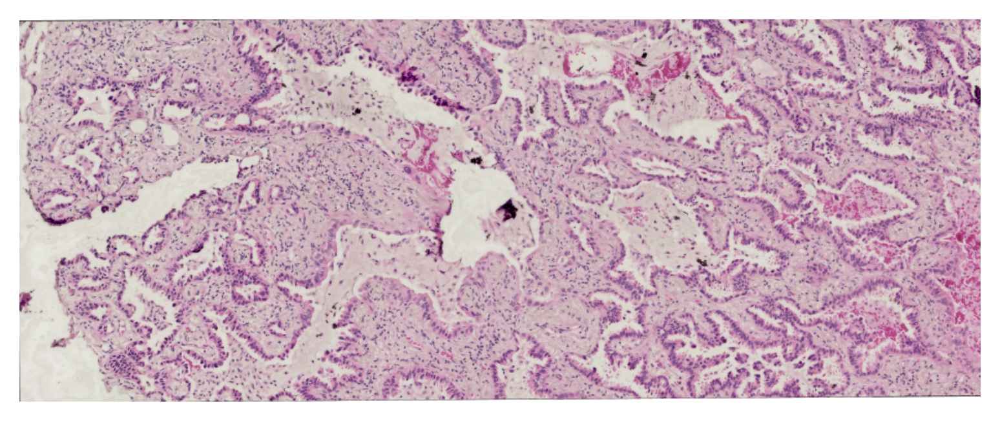

In [6]:
thumbnail = reader.slide_thumbnail(resolution=5, units="power")
plt.imshow(thumbnail)
plt.axis("off")
plt.show()

## Segmentation

In [7]:
from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import (
    overlay_prediction_contours,
)
from tiatoolbox.wsicore.wsireader import WSIReader

In [8]:
# Should be changed to False if no cuda-enabled GPU is available.
ON_GPU = True  # Default is True.

In [10]:
# Instantiate the nucleus instance segmentor
inst_segmentor = NucleusInstanceSegmentor(
    pretrained_model="hovernet_fast-pannuke",
    num_loader_workers=0,
    num_postproc_workers=0,
    batch_size=8,
    auto_generate_mask=False,
    verbose=False,
)

# WSI prediction
# if ON_GPU=False, this part will take more than a couple of hours to process.
wsi_output = inst_segmentor.predict(
    [file_path],
    masks=None,
    save_dir="HE_wsi_results2/",
    mode="wsi",
    on_gpu=ON_GPU,
    crash_on_exception=True,
)

Download from https://tiatoolbox.dcs.warwick.ac.uk/models/seg/hovernet_fast-pannuke.pth
Save to C:\Users\thu71\.tiatoolbox\models/hovernet_fast-pannuke.pth


|2024-01-25|18:03:47.966| [WARNING] Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
|2024-01-25|18:03:47.967| [WARNING] Metadata: Objective power inferred from microns-per-pixel (MPP).
Process Batch:   0%|                                      | 0/7 [00:00<?, ?it/s]|2024-01-25|18:03:49.353| [WARNING] Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
|2024-01-25|18:03:49.354| [WARNING] Metadata: Objective power inferred from microns-per-pixel (MPP).
Process Batch: 100%|##############################| 2/2 [00:04<00:00,  2.03s/it]


|2024-01-25|18:17:28.643| [INFO] Finish: 0
|2024-01-25|18:17:28.644| [INFO] --Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif
|2024-01-25|18:17:28.645| [INFO] --Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_results2\0


In [11]:
wsi_output

[['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1197_40X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_results2\\0']]

In [12]:
wsi_pred = joblib.load(f"{wsi_output[0][1]}.dat")
logger.info("Number of detected nuclei: %d", len(wsi_pred))

# Extracting the nucleus IDs and select a random nucleus
rng = np.random.default_rng()
nuc_id_list = list(wsi_pred.keys())
selected_nuc_id = nuc_id_list[
    rng.integers(0, len(wsi_pred))
]  # randomly select a nucleus
logger.info("Nucleus prediction structure for nucleus ID: %s", selected_nuc_id)
sample_nuc = wsi_pred[selected_nuc_id]
sample_nuc_keys = list(sample_nuc)
logger.info(
    "Keys in the output dictionary: [%s, %s, %s, %s, %s]",
    sample_nuc_keys[0],
    sample_nuc_keys[1],
    sample_nuc_keys[2],
    sample_nuc_keys[3],
    sample_nuc_keys[4],
)
logger.info(
    "Bounding box: (%d, %d, %d, %d)",
    sample_nuc["box"][0],
    sample_nuc["box"][1],
    sample_nuc["box"][2],
    sample_nuc["box"][3],
)
logger.info(
    "Centroid: (%d, %d)",
    sample_nuc["centroid"][0],
    sample_nuc["centroid"][1],
)

|2024-01-25|18:17:29.841| [INFO] Number of detected nuclei: 9188
|2024-01-25|18:17:29.842| [INFO] Nucleus prediction structure for nucleus ID: 19931261c51a4cb183f3a4ba95543c0e
|2024-01-25|18:17:29.843| [INFO] Keys in the output dictionary: [box, centroid, contour, prob, type]
|2024-01-25|18:17:29.844| [INFO] Bounding box: (500, 1105, 515, 1119)
|2024-01-25|18:17:29.844| [INFO] Centroid: (507, 1111)


|2024-01-25|18:17:29.888| [WARNING] Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
|2024-01-25|18:17:29.889| [WARNING] Metadata: Objective power inferred from microns-per-pixel (MPP).


|2024-01-25|18:17:29.889| [INFO] WSI original dimensions: (11162, 4438)
|2024-01-25|18:17:31.570| [INFO] WSI overview dimensions: (3350, 8426, 3)


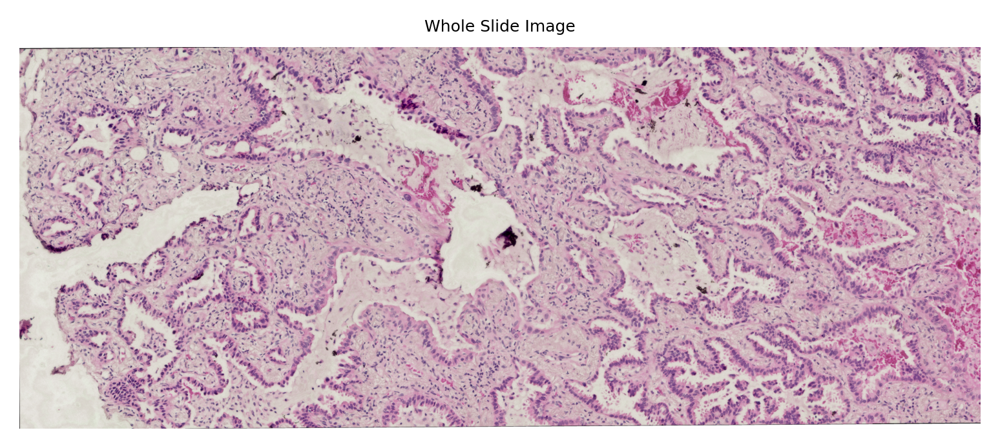

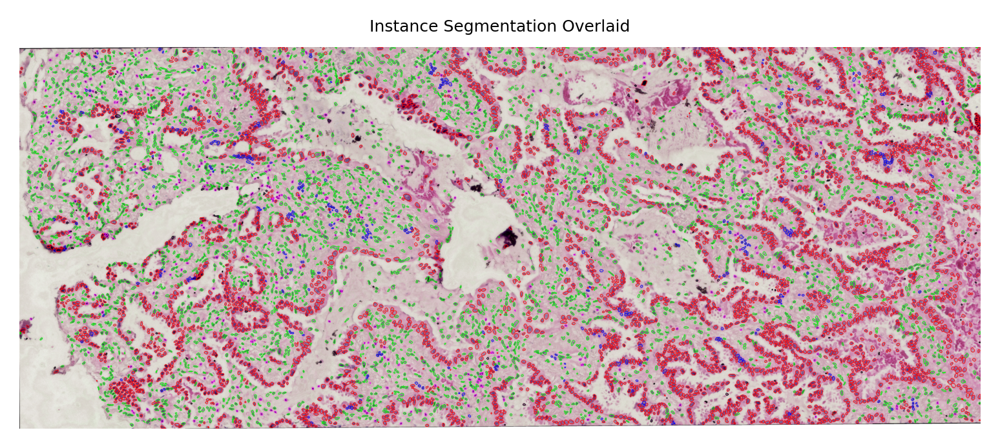

In [13]:
# [WSI overview extraction]
# Reading the WSI
wsi = WSIReader.open(file_path)
logger.info(
    "WSI original dimensions: (%d, %d)",
    wsi.info.slide_dimensions[0],
    wsi.info.slide_dimensions[1],
)

# Reading the whole slide in the highest resolution as a plane image
wsi_overview = wsi.slide_thumbnail(resolution=0.25, units="mpp")
logger.info(
    "WSI overview dimensions: (%d, %d, %d)",
    wsi_overview.shape[0],
    wsi_overview.shape[1],
    wsi_overview.shape[2],
)

# color_dict = {
#     0: ("nolabel", (0, 0, 0)),
#     1: ("epithelial", (255, 0, 0)),
#     2: ("lymphocyte", (0, 255, 0)),
#     3: ("macrophage", (0, 0, 255)),
#     4: ("neutrophil",(255, 255, 0)),
# }
color_dict = {
    0: ("neoplastic epithelial", (255, 0, 0)),
    1: ("Inflammatory", (255,0,255)),
    2: ("Connective", (0, 255, 0)),
    3: ("Dead", (0, 0, 0)),
    4: ("non-neoplastic epithelial", (255, 0, 0)),
}

# Create the overlay image
overlaid_predictions = overlay_prediction_contours(
    canvas=wsi_overview,
    inst_dict=wsi_pred,
    draw_dot=False,
    type_colours=color_dict,
    line_thickness=4,
)

# showing processed results alongside the original images
fig = (
    plt.figure(),
    plt.imshow(wsi_overview),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

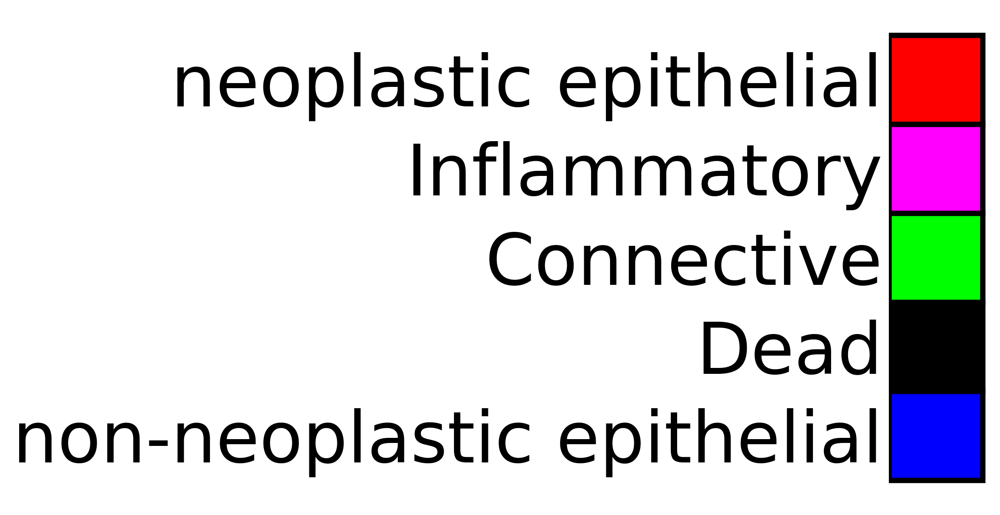

In [14]:
values = list(color_dict.values())
colors = [v[1] for v in values]
name = [v[0] for v in values]

# legend
fig, ax = plt.subplots(figsize=(1,len(colors)))
ax.barh(y=range(len(colors)), 
        color=np.array(colors)/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )

_ = plt.yticks(range(len(colors)), name, rotation=0, size=40)
_ = plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
# ax.yaxis.tick_right()
ax.invert_yaxis()
ax.grid(False)

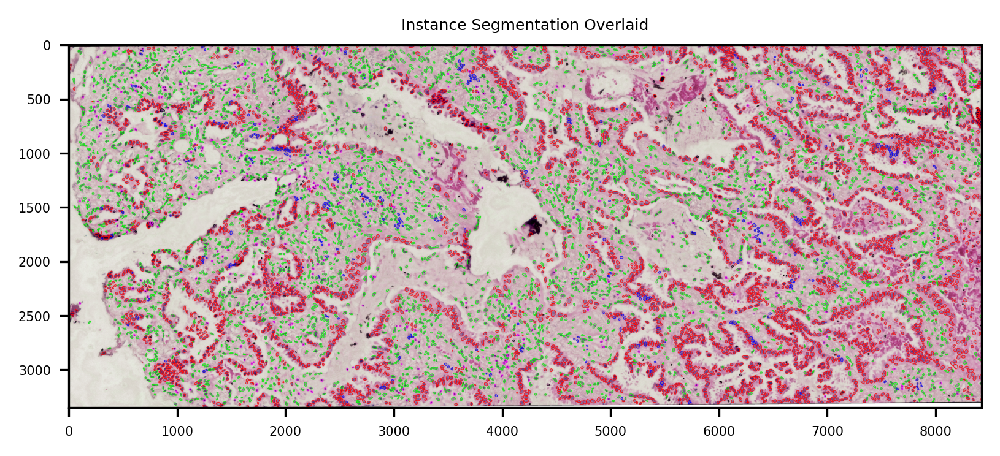

In [15]:
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.title("Instance Segmentation Overlaid"),
)

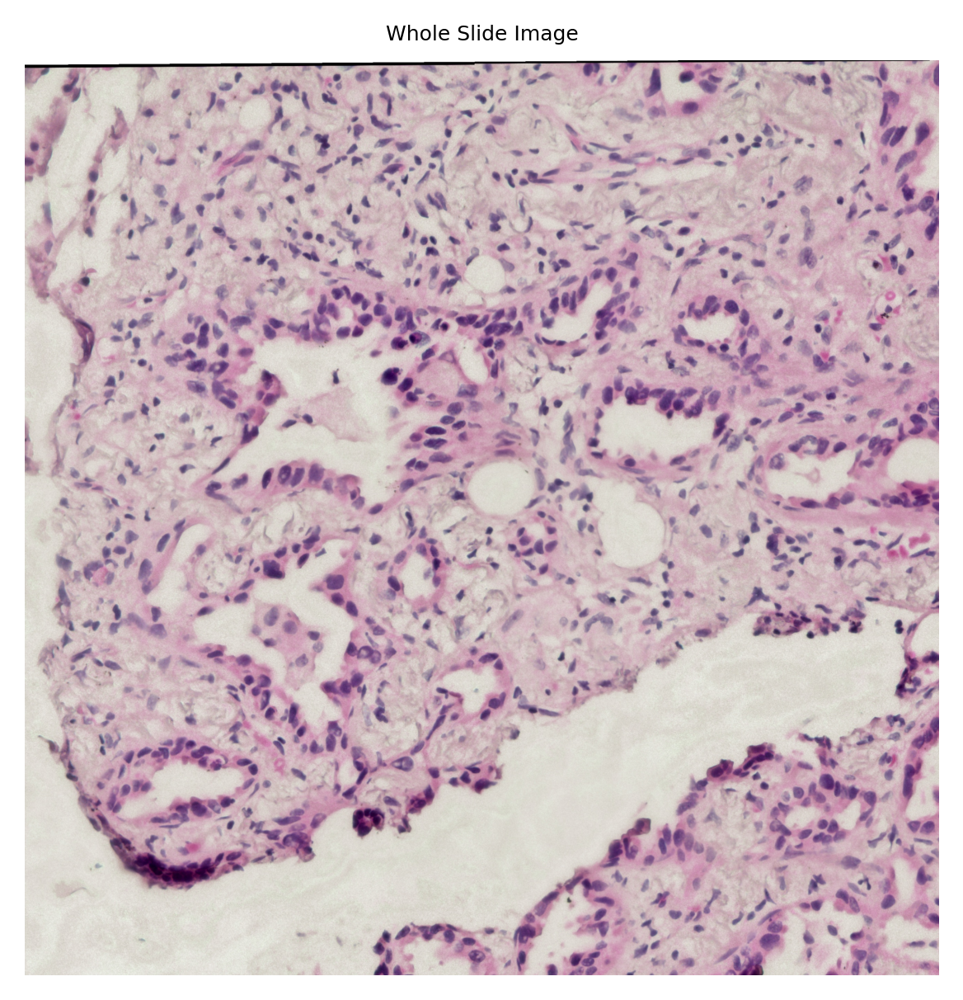

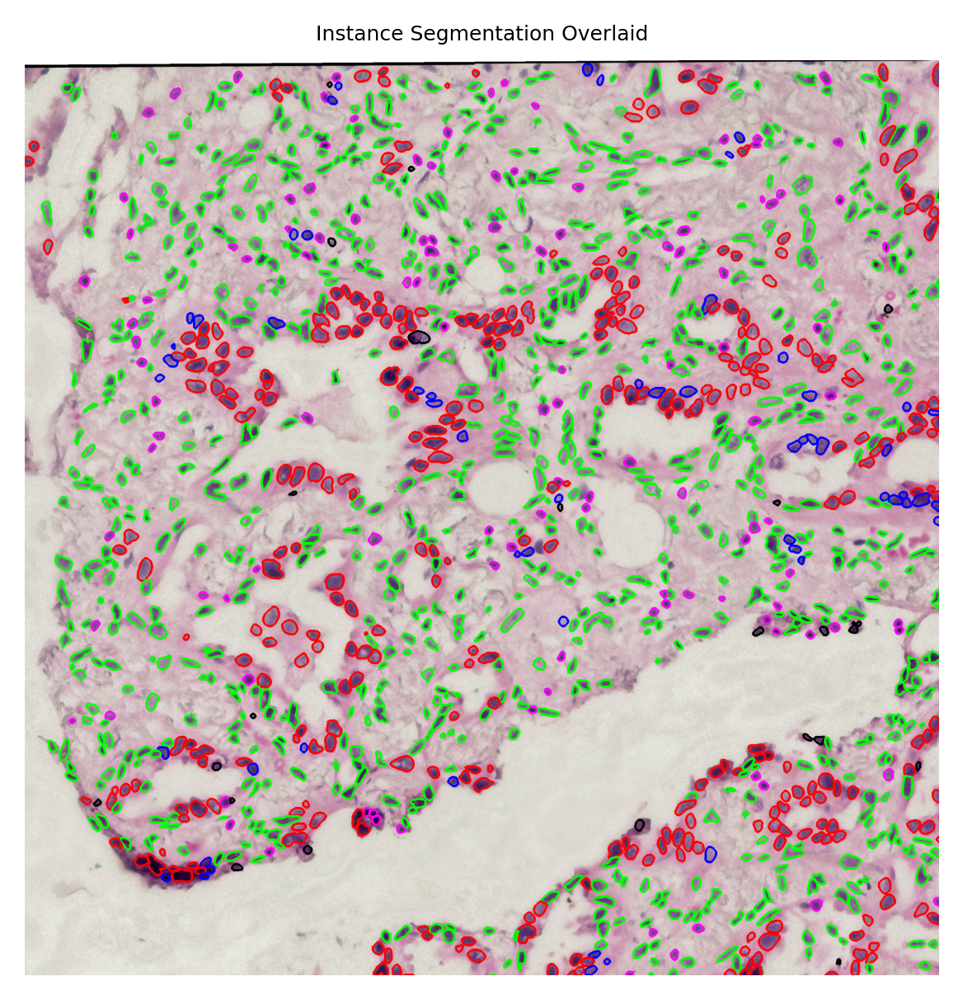

In [16]:
y_min, y_max = 0, 2000
x_min, x_max = 0, 2000
fig = (
    plt.figure(),
    plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

In [17]:
# y_min, y_max = 500, 2000
# x_min, x_max = 3200, 4800
# fig = (
#     plt.figure(),
#     plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
#     plt.axis("off"),
#     plt.title("Whole Slide Image"),
# )
# fig = (
#     plt.figure(),
#     plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
#     plt.axis("off"),
#     plt.title("Instance Segmentation Overlaid"),
# )

In [61]:
# y_min, y_max = 500, 2000
# x_min, x_max = 0, 1500
# fig = (
#     plt.figure(),
#     plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
#     plt.axis("off"),
#     plt.title("Whole Slide Image"),
# )
# fig = (
#     plt.figure(),
#     plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
#     plt.axis("off"),
#     plt.title("Instance Segmentation Overlaid"),
# )

# LOOP

In [73]:
file_paths = [r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif',
              r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1210_40X.ome.tif',]


In [74]:
from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import (
    overlay_prediction_contours,
)
from tiatoolbox.wsicore.wsireader import WSIReader

In [75]:
# Should be changed to False if no cuda-enabled GPU is available.
ON_GPU = True  # Default is True.

In [76]:
# Instantiate the nucleus instance segmentor
inst_segmentor = NucleusInstanceSegmentor(
    pretrained_model="hovernet_fast-pannuke",
    num_loader_workers=0,
    num_postproc_workers=0,
    batch_size=8,
    auto_generate_mask=False,
    verbose=False,
)

# WSI prediction
# if ON_GPU=False, this part will take more than a couple of hours to process.
wsi_output = inst_segmentor.predict(
    file_paths,
    masks=None,
    save_dir="HE_wsi_results/",
    mode="wsi",
    on_gpu=ON_GPU,
    crash_on_exception=True,
)

Download from https://tiatoolbox.dcs.warwick.ac.uk/models/seg/hovernet_fast-pannuke.pth
Save to C:\Users\thu71\.tiatoolbox\models/hovernet_fast-pannuke.pth


Process Batch: 100%|##############################| 2/2 [00:01<00:00,  1.67it/s]
INFO:root:Finish: 0
INFO:root:--Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif
INFO:root:--Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_results\0
Process Batch: 100%|##############################| 2/2 [00:01<00:00,  1.69it/s]
INFO:root:Finish: 0
INFO:root:--Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1210_40X.ome.tif
INFO:root:--Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_results\1


In [78]:
wsi_output

[['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1197_40X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_results\\0'],
 ['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1210_40X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_results\\1']]

In [87]:
import pickle 
with open("wsi.pickle", "wb") as f:
    pickle.dump(wsi_output, f)

In [82]:
file_path = wsi_output[1][0]
wsi_pred = joblib.load(f"{wsi_output[1][1]}.dat")
logger.info("Number of detected nuclei: %d", len(wsi_pred))

# Extracting the nucleus IDs and select a random nucleus
rng = np.random.default_rng()
nuc_id_list = list(wsi_pred.keys())
selected_nuc_id = nuc_id_list[
    rng.integers(0, len(wsi_pred))
]  # randomly select a nucleus
logger.info("Nucleus prediction structure for nucleus ID: %s", selected_nuc_id)
sample_nuc = wsi_pred[selected_nuc_id]
sample_nuc_keys = list(sample_nuc)
logger.info(
    "Keys in the output dictionary: [%s, %s, %s, %s, %s]",
    sample_nuc_keys[0],
    sample_nuc_keys[1],
    sample_nuc_keys[2],
    sample_nuc_keys[3],
    sample_nuc_keys[4],
)
logger.info(
    "Bounding box: (%d, %d, %d, %d)",
    sample_nuc["box"][0],
    sample_nuc["box"][1],
    sample_nuc["box"][2],
    sample_nuc["box"][3],
)
logger.info(
    "Centroid: (%d, %d)",
    sample_nuc["centroid"][0],
    sample_nuc["centroid"][1],
)

INFO:root:Number of detected nuclei: 6682
INFO:root:Nucleus prediction structure for nucleus ID: 009018b6d1c74d20ad6da0f260949f82
INFO:root:Keys in the output dictionary: [box, centroid, contour, prob, type]
INFO:root:Bounding box: (6142, 3680, 6163, 3699)
INFO:root:Centroid: (6152, 3688)


INFO:root:WSI original dimensions: (8522, 5560)


INFO:root:WSI overview dimensions: (4197, 6433, 3)


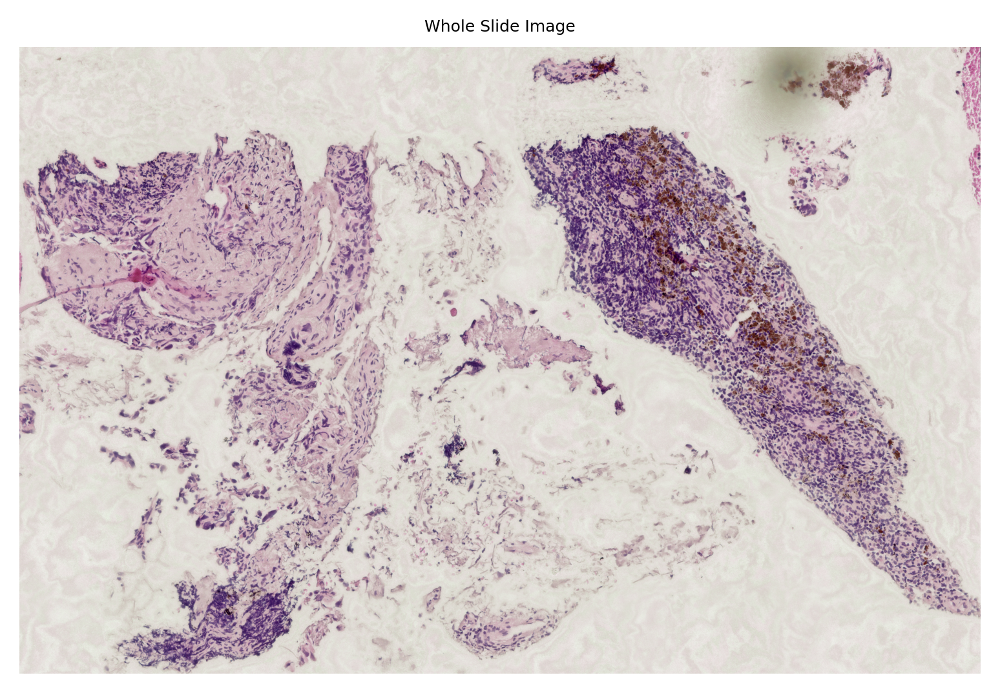

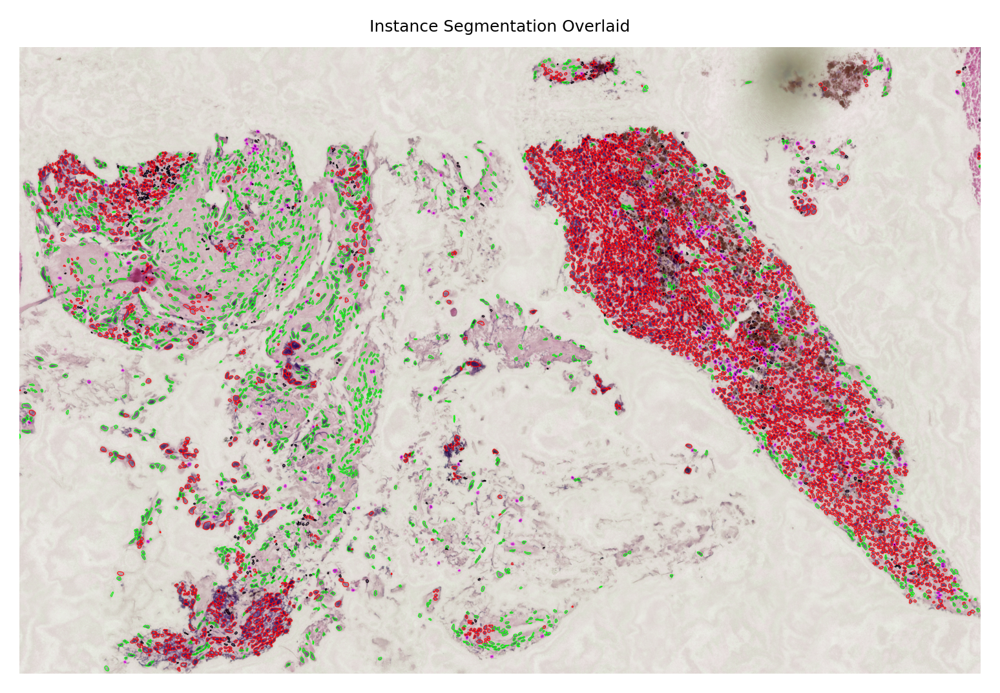

In [83]:
# [WSI overview extraction]
# Reading the WSI
wsi = WSIReader.open(file_path)
logger.info(
    "WSI original dimensions: (%d, %d)",
    wsi.info.slide_dimensions[0],
    wsi.info.slide_dimensions[1],
)

# Reading the whole slide in the highest resolution as a plane image
wsi_overview = wsi.slide_thumbnail(resolution=0.25, units="mpp")
logger.info(
    "WSI overview dimensions: (%d, %d, %d)",
    wsi_overview.shape[0],
    wsi_overview.shape[1],
    wsi_overview.shape[2],
)

# color_dict = {
#     0: ("nolabel", (0, 0, 0)),
#     1: ("epithelial", (255, 0, 0)),
#     2: ("lymphocyte", (0, 255, 0)),
#     3: ("macrophage", (0, 0, 255)),
#     4: ("neutrophil",(255, 255, 0)),
# }
color_dict = {
    0: ("neoplastic epithelial", (255, 0, 0)),
    1: ("Inflammatory", (255,0,255)),
    2: ("Connective", (0, 255, 0)),
    3: ("Dead", (0, 0, 0)),
    4: ("non-neoplastic epithelial", (255, 0, 0)),
}

# Create the overlay image
overlaid_predictions = overlay_prediction_contours(
    canvas=wsi_overview,
    inst_dict=wsi_pred,
    draw_dot=False,
    type_colours=color_dict,
    line_thickness=4,
)

# showing processed results alongside the original images
fig = (
    plt.figure(),
    plt.imshow(wsi_overview),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

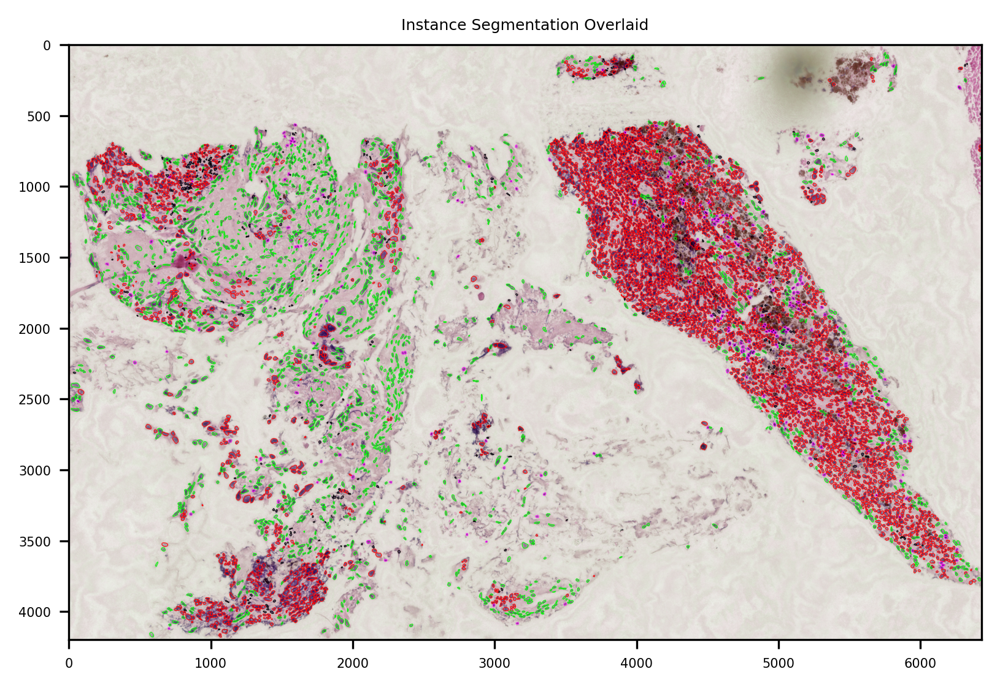

In [84]:
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.title("Instance Segmentation Overlaid"),
)

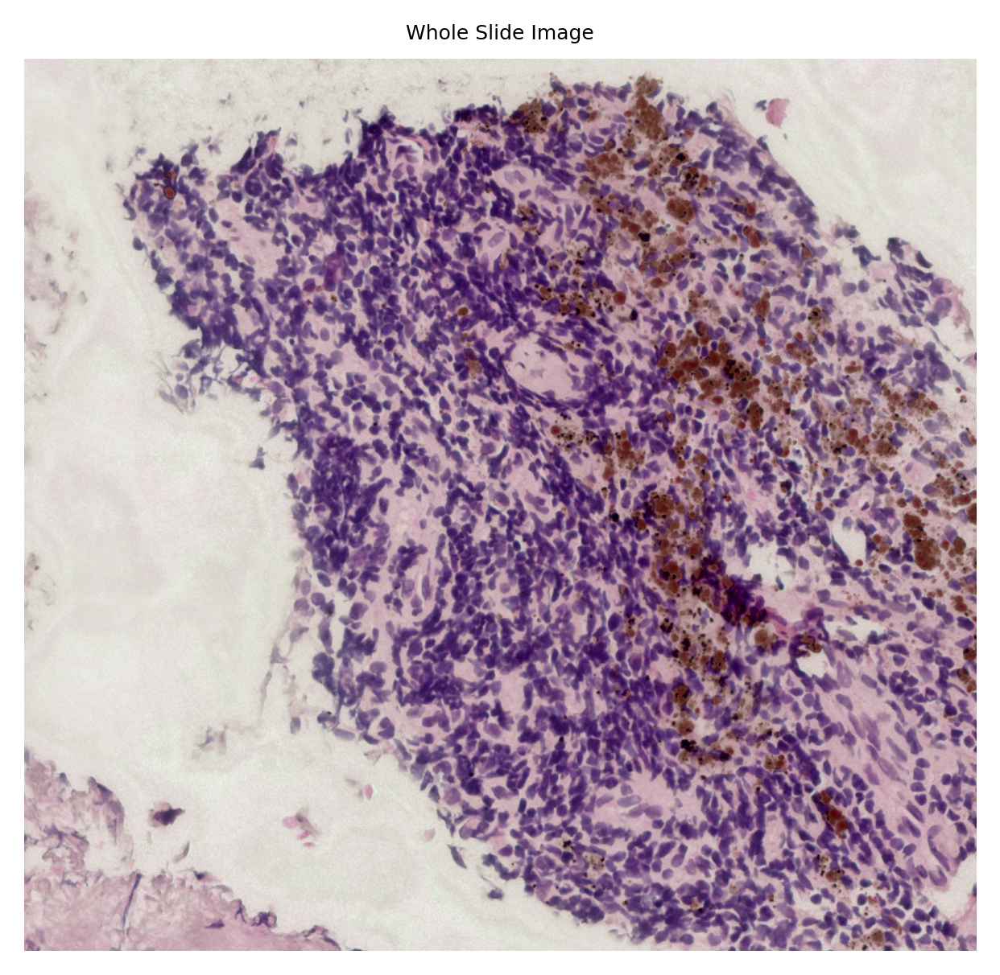

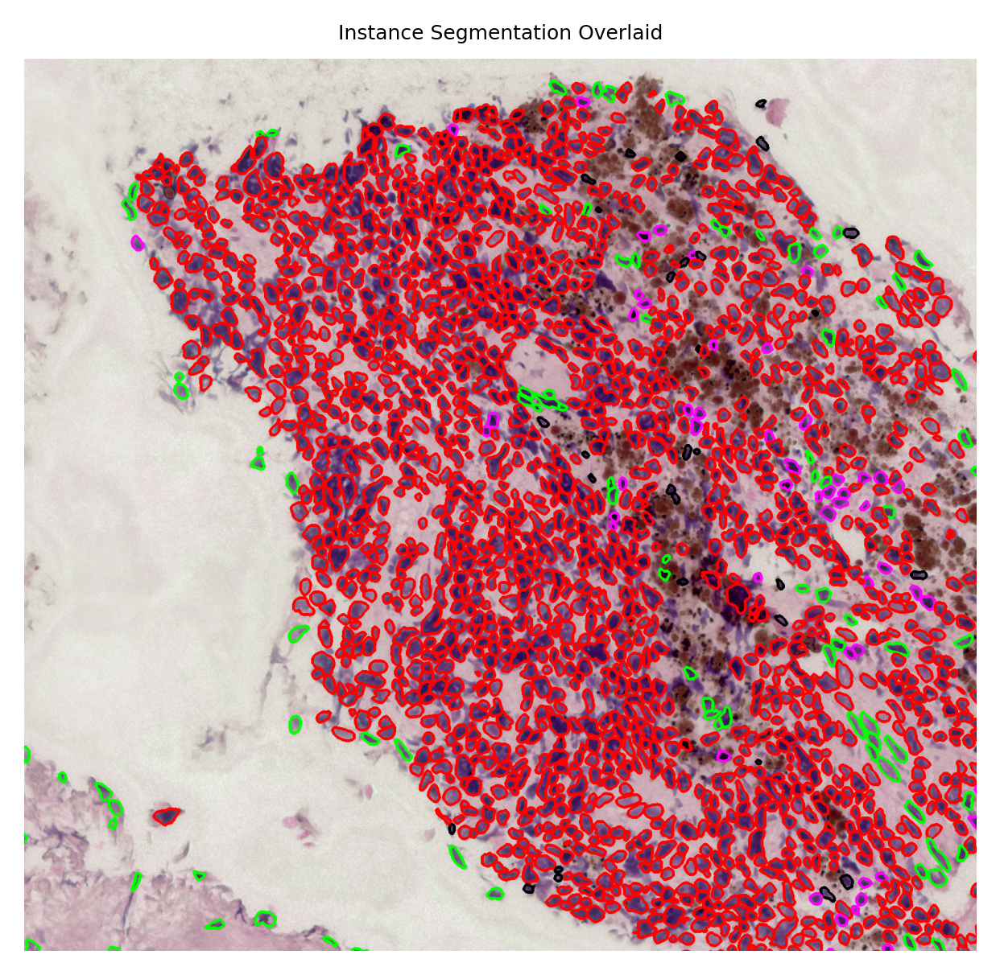

In [85]:
y_min, y_max = 500, 2000
x_min, x_max = 3200, 4800
fig = (
    plt.figure(),
    plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

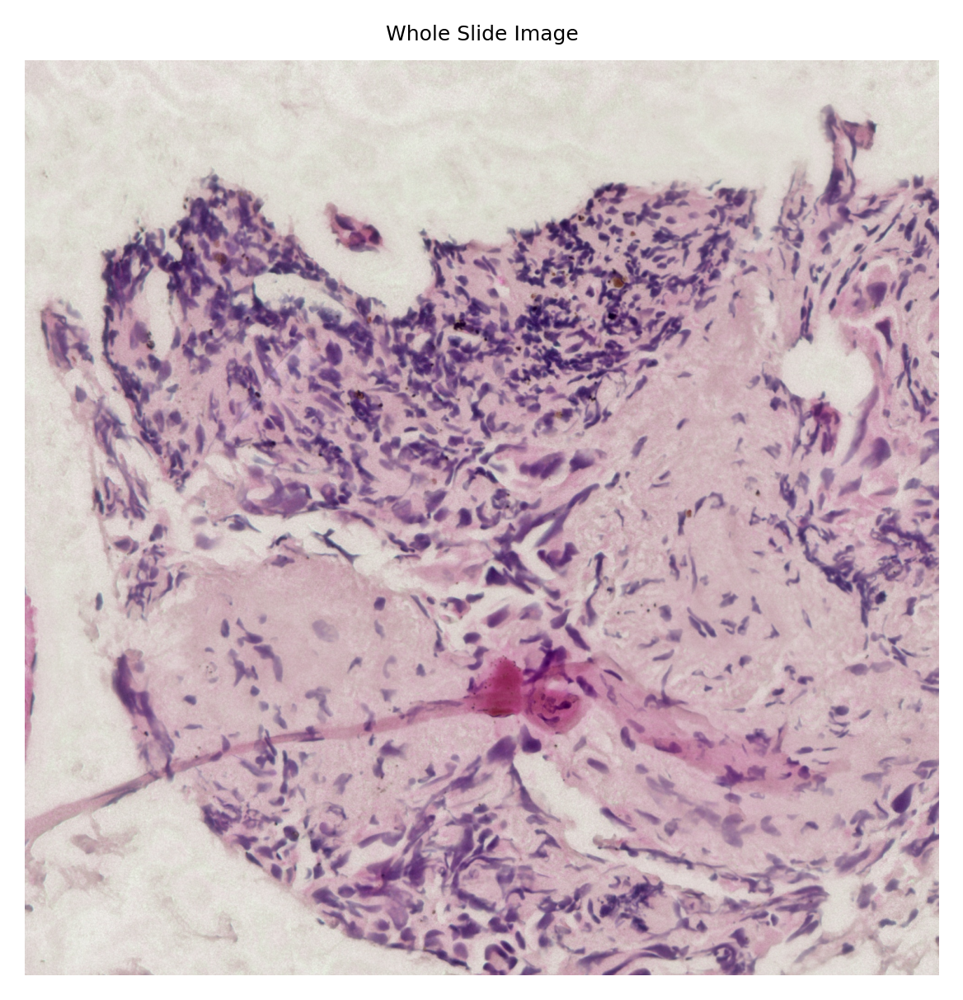

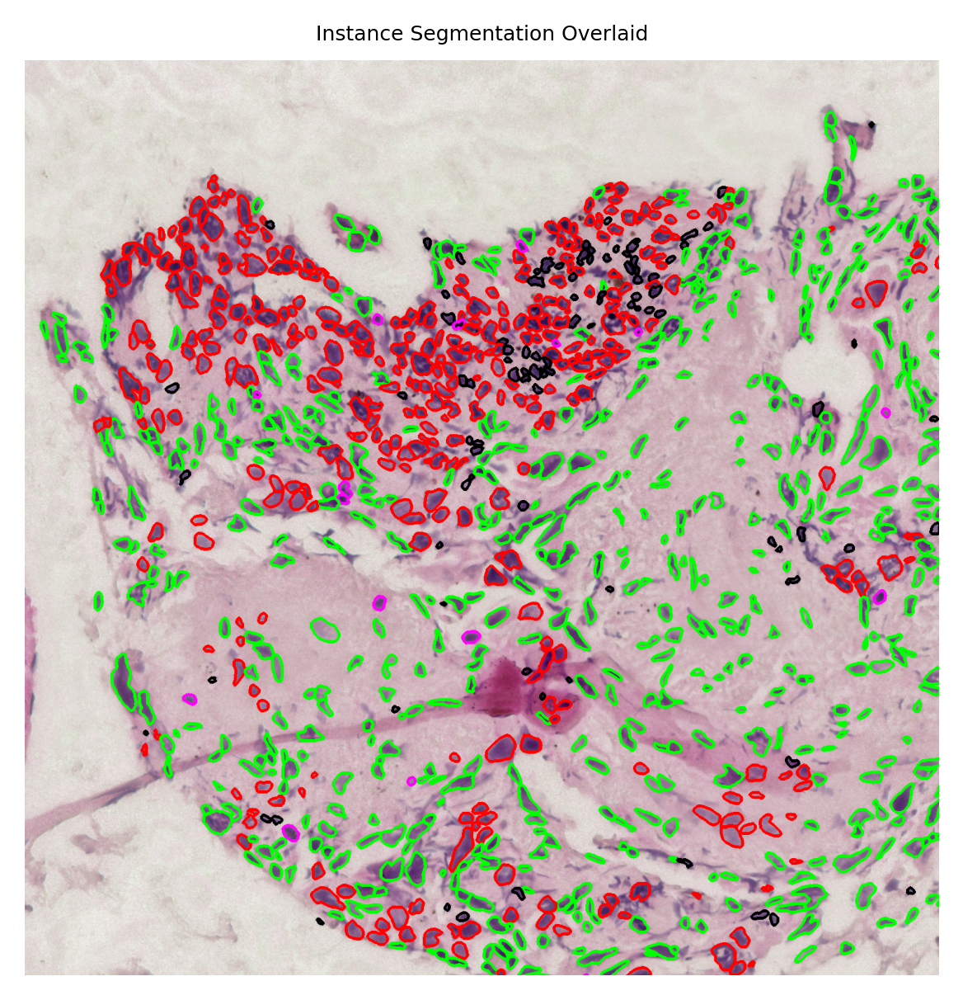

In [86]:
y_min, y_max = 500, 2000
x_min, x_max = 0, 1500
fig = (
    plt.figure(),
    plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)